In [ ]:
!pip install koreanize-matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 14.5 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np

from pylab import plt, mpl
from tqdm import tqdm

import warnings
warnings.filterwarnings('ignore')

import koreanize_matplotlib
%config InlineBackend.figure_format = 'retina'

In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-pastel')

In [ ]:
plt.rcParams['font.family'] = 'NanumGothic'
plt.rcParams['axes.unicode_minus'] = False

## Data_load

In [ ]:
# df.to_csv('/content/all_df.csv')
df = pd.read_csv('/content/trend+kalman.csv', index_col=0)
df

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,x_target,target
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.000476,0,0
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,1,0
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,1
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,1
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,1


In [ ]:
# df.to_csv('/content/all_df.csv')
before = pd.read_csv('/content/all_df.csv', index_col=0)
before

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,매도_주요그룹_합계,매수_주요그룹_합계,순매수_주요그룹_합계,외국인체결강도,일중강도,개인_활동성,거래대금,기관/개인 매수 비율,기관/개인 매도 비율,일중강도/거래량
TIME,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,16839849,23004824,6164975,1.097486,-4.406906e+07,185186358.0,4.572514e+11,0.130649,0.118728,-0.190316
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,19553477,22158115,2604638,0.770084,-1.475859e+08,170542114.5,4.200914e+11,0.138305,0.122017,-0.686624
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,20047953,21848614,1800661,1.012447,2.474680e+08,202558293.0,4.859950e+11,0.110877,0.102202,1.000000
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,27132442,27992226,859784,0.762284,-2.806919e+08,265030648.0,6.375905e+11,0.112973,0.108423,-0.850779
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,22877946,28321843,5443897,0.809457,-1.656350e+08,202360449.0,5.022034e+11,0.146204,0.119550,-0.637990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,23725758,29783880,6058122,1.251139,4.705460e+08,360651985.5,1.264564e+12,0.080599,0.065242,1.000000
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,28932911,27537305,-1395606,1.115162,-2.687497e+08,338322903.0,1.238572e+12,0.081038,0.085123,-0.584133
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,27529344,21640651,-5888693,0.959859,-1.032913e+08,254508147.5,9.421954e+11,0.087284,0.110927,-0.294204


In [ ]:
# df.to_csv('/content/all_df.csv')
after = pd.read_csv('/content/df.csv', index_col=0)
after

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,기관/개인 매도 비율,뉴스심리지수,USDKRW,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열)
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,0.118728,108.18,1063.599976,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,0.122017,105.28,1064.199951,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,0.102202,103.81,1066.099976,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,0.108423,104.68,1064.780029,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,0.119550,102.58,1067.030029,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,0.065242,108.39,1377.089966,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,0.085123,110.75,1374.640015,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,0.110927,110.86,1375.000000,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8


In [ ]:
label = pd.read_csv('/content/trend+kalman.csv', index_col=0)
label

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,x_target,target
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.000476,0,0
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,1,0
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,1
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,1
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,1


In [ ]:
train = label[label.index < '2023-03-01']

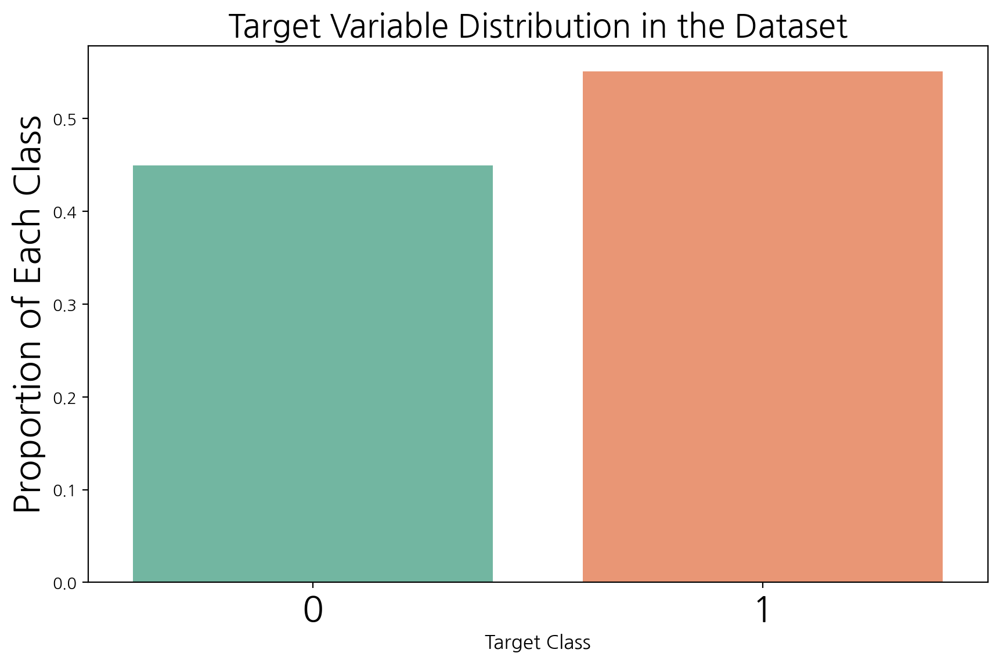

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


class_distribution = train['target'].value_counts(normalize=True)

plt.figure(figsize=(10, 6))
sns.barplot(x=class_distribution.index, y=class_distribution.values, palette='Set2')
plt.title('Target Variable Distribution in the Dataset', fontsize=20)
plt.xticks(fontsize=22)
plt.xlabel('Target Class', fontsize=12)
plt.ylabel('Proportion of Each Class', fontsize=22)
plt.show()

In [ ]:
label['kalman_ma_log'] = np.log(label['kalman_ma']/label['kalman_ma'].shift(1))
label.dropna(inplace=True)
label

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,x_target,target,kalman_ma_log
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0,0.000058
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0,0.000513
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,1,0,-0.001062
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,1,0,-0.000872
2014-03-14,1916.07,1927.89,1913.64,1919.90,254025556,1138300480270649,5680657,5602901,-77756,4012704,...,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.007514,1,0,-0.001497
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,1,0.000917
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,1,0.000994
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,1,0.000598


In [ ]:
label.

In [ ]:
label.drop(columns={'x_target', '매도_전체', '매수_전체', '순매수_전체', 'Open', 'High', 'Low', 'Close', 'Volume', 'MarCap', '매도_기관합계', '매수_기관합계', '순매수_기관합계'}, inplace=True)
label

,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,매수_보험,순매수_보험,매도_투신,매수_투신,순매수_투신,매도_사모,...,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,target,kalman_ma_log
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-10,4957687,3914211,-1043476,3045944,2597904,-448040,5975523,7588043,1612520,1301200,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0.000058
2014-03-11,3837210,4029193,191983,3804816,3701682,-103134,5853754,6759214,905460,1692833,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0.000513
2014-03-12,6588397,7599838,1011441,3966236,3325850,-640386,6223686,5171342,-1052344,2816527,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,0,-0.001062
2014-03-13,5901313,6934734,1033421,2884637,3750337,865700,6838476,7195539,357063,1578748,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,0,-0.000872
2014-03-14,5680657,5602901,-77756,4012704,3793863,-218841,5093067,7677718,2584651,1850849,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.007514,0,-0.001497
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,5353046,10015015,4661969,1479298,1109345,-369953,2449275,2837403,388128,2034855,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,0.000917
2024-04-30,6073768,9027473,2953705,1548253,1124230,-424023,4438740,4171464,-267276,3314911,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,0.000994
2024-05-02,7429768,4868198,-2561570,1366408,826518,-539890,3039297,2688007,-351290,2887254,...,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,0.000598


In [ ]:
y = label[['target', 'r']]
y.index

Index(['2014-01-03', '2014-01-06', '2014-01-07', '2014-01-08', '2014-01-09',
       '2014-01-10', '2014-01-13', '2014-01-14', '2014-01-15', '2014-01-16',
       ...
       '2024-04-22', '2024-04-23', '2024-04-24', '2024-04-25', '2024-04-26',
       '2024-04-29', '2024-04-30', '2024-05-02', '2024-05-03', '2024-05-07'],
      dtype='object', name='Date', length=2543)

In [ ]:
y.rename(columns = {'target': 'x_target', 'r':'x_r'}, inplace=True)

In [ ]:
y.index = pd.to_datetime(y.index)
after.index = pd.to_datetime(after.index)

In [ ]:
y

,x_target,x_r
Date,,
2014-01-03,1.0,-0.010758
2014-01-06,-1.0,0.003662
2014-01-07,-1.0,0.003149
2014-01-08,1.0,-0.000245
2014-01-09,1.0,-0.006581
...,...,...
2024-04-29,1.0,0.011644
2024-04-30,1.0,0.001718
2024-05-02,1.0,-0.003129


In [ ]:
# merged = after.join(y, how='left')
merged.drop(columns=['x_r'], inplace=True)

In [ ]:
# merged['x_target'] = merged['x_target'].apply(lambda x: 0 if x == -1 else 1)
merged[['target', 'x_target', 'r']]

,target,x_target,r
Date,,,
2014-03-07,0,0,-0.000476
2014-03-10,0,0,-0.010313
2014-03-11,0,0,0.004824
2014-03-12,0,1,-0.016082
2014-03-13,0,1,0.000952
...,...,...,...
2024-04-29,1,1,0.011644
2024-04-30,1,1,0.001718
2024-05-02,1,1,-0.003129


In [ ]:
merged = merged[['Open', 'High', 'Low', 'Close', 'Volume', 'MarCap', '매도_금융투자',
       '매수_금융투자', '순매수_금융투자', '매도_보험', '매수_보험', '순매수_보험', '매도_투신', '매수_투신',
       '순매수_투신', '매도_사모', '매수_사모', '순매수_사모', '매도_은행', '매수_은행', '순매수_은행',
       '매도_기타금융', '매수_기타금융', '순매수_기타금융', '매도_연기금 등', '매수_연기금 등', '순매수_연기금 등',
       '매도_기관합계', '매수_기관합계', '순매수_기관합계', '매도_기타법인', '매수_기타법인', '순매수_기타법인',
       '매도_개인', '매수_개인', '순매수_개인', '매도_외국인', '매수_외국인', '순매수_외국인', '매도_기타외국인',
       '매수_기타외국인', '순매수_기타외국인', '매도_전체', '매수_전체', '순매수_전체', 'kalman_ma',
       'volume_cmf', 'volume_fi', 'volume_mfi', 'volume_sma_em', 'volume_vpt',
       'volatility_atr', 'volatility_ui', 'trend_macd_diff', 'trend_adx',
       'trend_trix', 'trend_mass_index', 'trend_dpo', 'trend_aroon_ind',
       'momentum_rsi', 'momentum_wr', 'volatility_bbm', 'volatility_bbh',
       'volatility_bbl', 'volatility_kcc', 'volatility_kch', 'volatility_kcl',
       'trend_psar', 'momentum_stoch', 'momentum_tsi', 'momentum_roc',
       'momentum_ao', 'momentum_cci', 'trend_kst', 'trend_kst_sig',
       'trend_kst_diff', 'trend_aroon_up', 'trend_aroon_down',
       'volatility_dch', 'volatility_dcl', 'volatility_dcm',
       'trend_ichimoku_a', 'trend_ichimoku_b', 'trend_ichimoku_base',
       'trend_ichimoku_conv', 'vol_change_5', 'ret_5', 'vol_change_10',
       'ret_10', 'vol_change_20', 'ret_20', 'std_30', 'vol_std_30', 'dowjones',
       'nasdaq', 's&p500', '금융투자_매수/매도 비율', '보험_매수/매도 비율', '매도_주요그룹_합계',
       '매수_주요그룹_합계', '순매수_주요그룹_합계', '외국인체결강도', '개인_활동성', '기관/개인 매수 비율',
       '기관/개인 매도 비율', '뉴스심리지수', 'USDKRW', '경제심리지수', '경상수지', '상품수지',
       '수출금액 (천불)', '수입금액 (천불)', '무역수지 (천불)', 'M2(평잔 원계열)','r', 'x_target', 'target']]

In [ ]:
merged.to_csv('/content/with.csv')

In [ ]:
before.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'MarCap', '매도_금융투자',
       '매수_금융투자', '순매수_금융투자', '매도_보험', '매수_보험', '순매수_보험', '매도_투신', '매수_투신',
       '순매수_투신', '매도_사모', '매수_사모', '순매수_사모', '매도_은행', '매수_은행', '순매수_은행',
       '매도_기타금융', '매수_기타금융', '순매수_기타금융', '매도_연기금 등', '매수_연기금 등', '순매수_연기금 등',
       '매도_기관합계', '매수_기관합계', '순매수_기관합계', '매도_기타법인', '매수_기타법인', '순매수_기타법인',
       '매도_개인', '매수_개인', '순매수_개인', '매도_외국인', '매수_외국인', '순매수_외국인', '매도_기타외국인',
       '매수_기타외국인', '순매수_기타외국인', '매도_전체', '매수_전체', 'r', 'target', 'volume_cmf',
       'volume_fi', 'volume_mfi', 'volume_sma_em', 'volume_vpt',
       'volatility_atr', 'volatility_ui', 'trend_macd_diff', 'trend_adx',
       'trend_trix', 'trend_mass_index', 'trend_dpo', 'trend_aroon_ind',
       'momentum_rsi', 'momentum_wr', 'vol_change_5', 'ret_5', 'vol_change_10',
       'ret_10', 'vol_change_20', 'ret_20', 'std_30', 'vol_std_30', 'dowjones',
       'nasdaq', 's&p500', '뉴스심리지수', 'USDKRW', '경제심리지수', '경상수지', '상품수지',
       '수출금액 (천불)', '수입금액 

## 3개 그룹

In [ ]:
!pip install pykrx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.6/52.6 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.8/247.8 kB 30.2 MB/s eta 0:00:00


In [ ]:
from pykrx import stock
from pykrx import bond

stock.get_market_trading_volume_by_investor("20210115", "20210122", "KOSPI")

,매도,매수,순매수
투자자구분,,,
금융투자,137969209,127697577,-10271632
보험,15737709,8577242,-7160467
투신,46872846,34307243,-12565603
사모,20780475,16342937,-4437538
은행,2236667,632814,-1603853
기타금융,9782040,1794977,-7987063
연기금 등,173755019,136945792,-36809227
기관합계,407133965,326298582,-80835383
기타법인,44561821,42901283,-1660538


In [ ]:
data = df['매도_금융투자',
       '매수_금융투자', '순매수_금융투자', '매도_보험', '매수_보험', '순매수_보험', '매도_투신', '매수_투신',
       '순매수_투신', '매도_사모', '매수_사모', '순매수_사모', '매도_은행', '매수_은행', '순매수_은행',
       '매도_기타금융', '매수_기타금융', '순매수_기타금융', '매도_연기금 등', '매수_연기금 등', '순매수_연기금 등',
       '매도_기관합계', '매수_기관합계', '순매수_기관합계', '매도_기타법인', '매수_기타법인', '순매수_기타법인',
       '매도_개인', '매수_개인', '순매수_개인', '매도_외국인', '매수_외국인', '순매수_외국인', '매도_기타외국인',
       '매수_기타외국인', '순매수_기타외국인', '매도_전체', '매수_전체', '순매수_전체', 'target']

In [ ]:
data = pd.DataFrame()

In [ ]:
data['기관_매수'] = (
    df['매수_금융투자'] + df['매수_보험'] + df['매수_투신'] +
    df['매수_사모'] + df['매수_은행'] + df['매수_기타금융'] +
    df['매수_연기금 등'] + df['매수_기관합계'] + df['매수_기타법인']
)

data['기관_매도'] = (
    df['매도_금융투자'] + df['매도_보험'] + df['매도_투신'] +
    df['매도_사모'] + df['매도_은행'] + df['매도_기타금융'] +
    df['매도_연기금 등'] + df['매도_기관합계'] + df['매도_기타법인']
)

data['기관_순매수'] = (
    df['순매수_금융투자'] + df['순매수_보험'] + df['순매수_투신'] +
    df['순매수_사모'] + df['순매수_은행'] + df['순매수_기타금융'] +
    df['순매수_연기금 등'] + df['순매수_기관합계'] + df['순매수_기타법인']
)


In [ ]:
data['외국인_매수'] = df['매수_외국인'] + df['매수_기타외국인']
data['외국인_매도'] = df['매도_외국인'] + df['매도_기타외국인']
data['외국인_순매수'] = df['순매수_외국인'] + df['순매수_기타외국인']

In [ ]:
data['개인_매수'] = df['매수_개인']
data['개인_매도'] = df['매도_개인']
data['개인_순매수'] = df['순매수_개인']

In [ ]:
data['momentum_rsi'] = df['momentum_rsi']

In [ ]:
data['외국인체결강도'] = df['외국인체결강도']

In [ ]:
data

,외국인_매수,외국인_매도,외국인_순매수,기관_매수,기관_매도,기관_순매수,개인_매수,개인_매도,개인_순매수
Date,,,,,,,,,
2014-03-07,21377940,19433702,1944238,51656319,46999600,4656719,183002721,187369995,-4367274
2014-03-10,16456524,21315626,-4859102,48581123,46172037,2409086,173134908,167949321,5185587
2014-03-11,21380482,21258785,121697,46906830,43610320,3296510,201731405,203385181,-1653776
2014-03-12,25245181,32626984,-7381803,61133801,67774637,-6640836,272627659,257433637,15194022
2014-03-13,25682801,31772583,-6089782,60513012,50177795,10335217,202927039,201793859,1133180
...,...,...,...,...,...,...,...,...,...
2024-04-29,87584923,70347982,17236941,64443686,51772576,12671110,348560049,372743922,-24183873
2024-04-30,95369611,85571413,9798198,58550441,60974474,-2424033,333935825,342709981,-8774156
2024-05-02,67238719,69875974,-2637255,46609962,58978566,-12368604,259056181,249960114,9096067


In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-pastel')

In [ ]:
df

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,x_target,target
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.000476,0,0
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,1,0
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,1
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,1
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,1


In [ ]:
data[['x_target', 'target']] = df[['x_target', 'target']]
data

,외국인_매수,외국인_매도,외국인_순매수,기관_매수,기관_매도,기관_순매수,개인_매수,개인_매도,개인_순매수,target,x_target
Date,,,,,,,,,,,
2014-03-07,21377940,19433702,1944238,51656319,46999600,4656719,183002721,187369995,-4367274,0,0
2014-03-10,16456524,21315626,-4859102,48581123,46172037,2409086,173134908,167949321,5185587,0,0
2014-03-11,21380482,21258785,121697,46906830,43610320,3296510,201731405,203385181,-1653776,0,0
2014-03-12,25245181,32626984,-7381803,61133801,67774637,-6640836,272627659,257433637,15194022,0,1
2014-03-13,25682801,31772583,-6089782,60513012,50177795,10335217,202927039,201793859,1133180,0,1
...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,87584923,70347982,17236941,64443686,51772576,12671110,348560049,372743922,-24183873,1,1
2024-04-30,95369611,85571413,9798198,58550441,60974474,-2424033,333935825,342709981,-8774156,1,1
2024-05-02,67238719,69875974,-2637255,46609962,58978566,-12368604,259056181,249960114,9096067,1,1


In [ ]:
data['']

In [ ]:
cols = ['외국인_매수', '외국인_매도', '외국인_순매수']
# cols = ['개인_매수', '개인_매도', '개인_순매수']
# cols = ['기관_매수', '기관_매도', '기관_순매수']


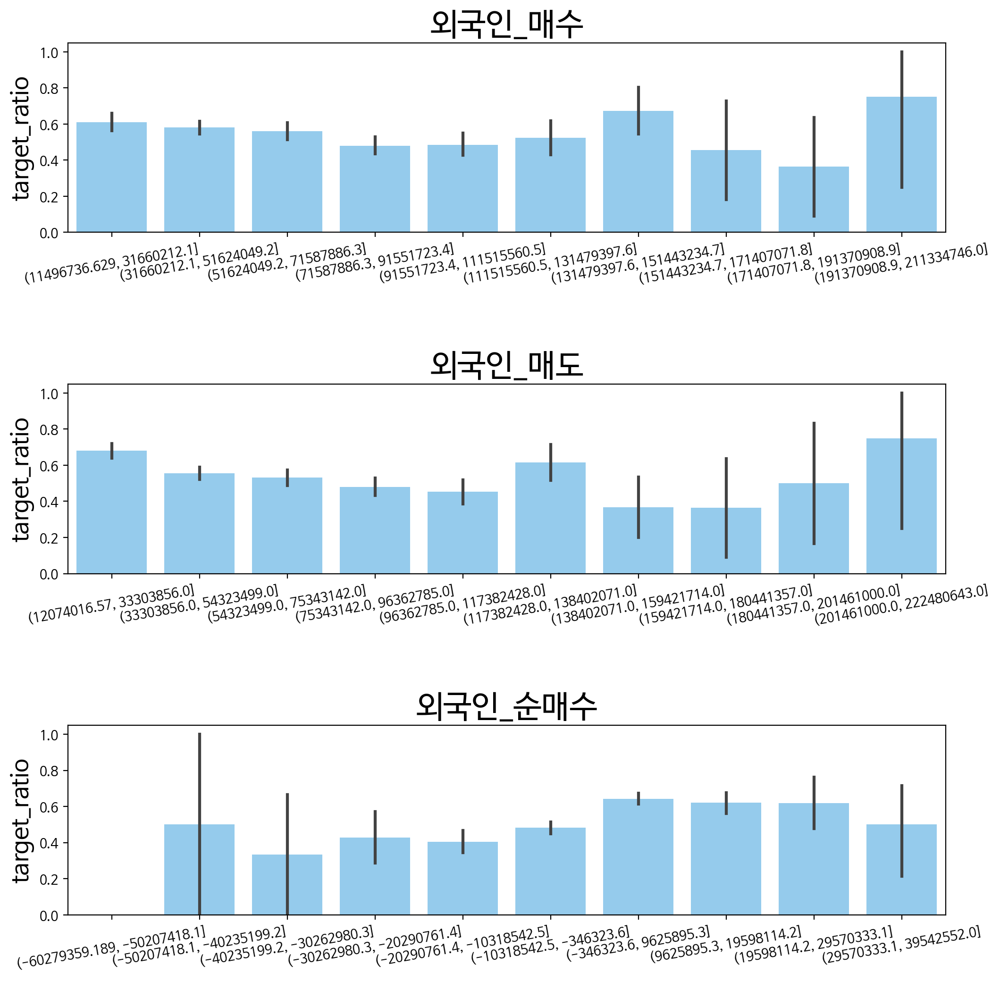

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.gridspec as gridspec

plt.figure(figsize=(12, len(cols)*4))
grid = gridspec.GridSpec(len(cols), 1)
plt.subplots_adjust(wspace=0.4, hspace=0.8)

df_cut = data.copy()

for idx, col in enumerate(cols):
    df_cut[col] = pd.cut(data[col], 10)

    ax = plt.subplot(grid[idx])
    sns.barplot(x=col, y='target', data=df_cut, color='lightskyblue', ax=ax)
    ax.tick_params(axis='x', labelrotation=10)
    ax.set_title(col, fontsize=24)
    ax.set_xlabel('')
    ax.set_ylabel('target_ratio', fontsize=18)

plt.show()

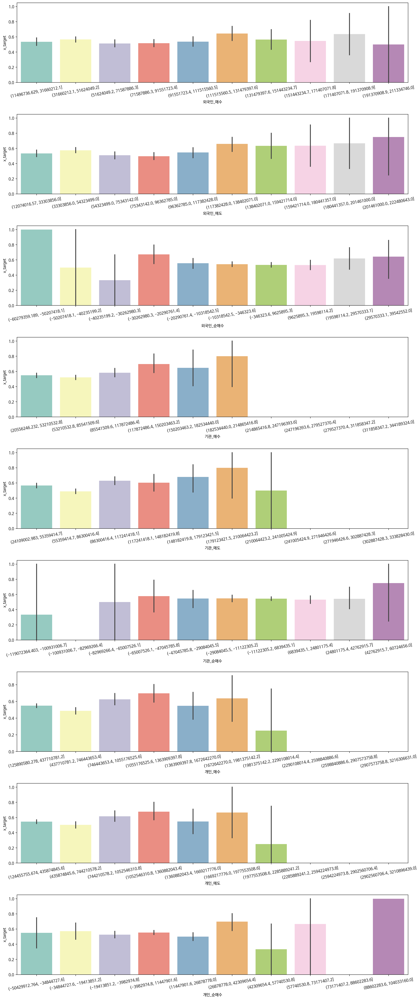

In [ ]:
plt.figure(figsize=(18, len(cols)*5))
grid = gridspec.GridSpec(len(cols), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = data.copy()

for idx, col in enumerate(cols):
        df_cut[col] = pd.cut(data[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='x_target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
features = ['외국인체결강도', 'momentum_rsi']

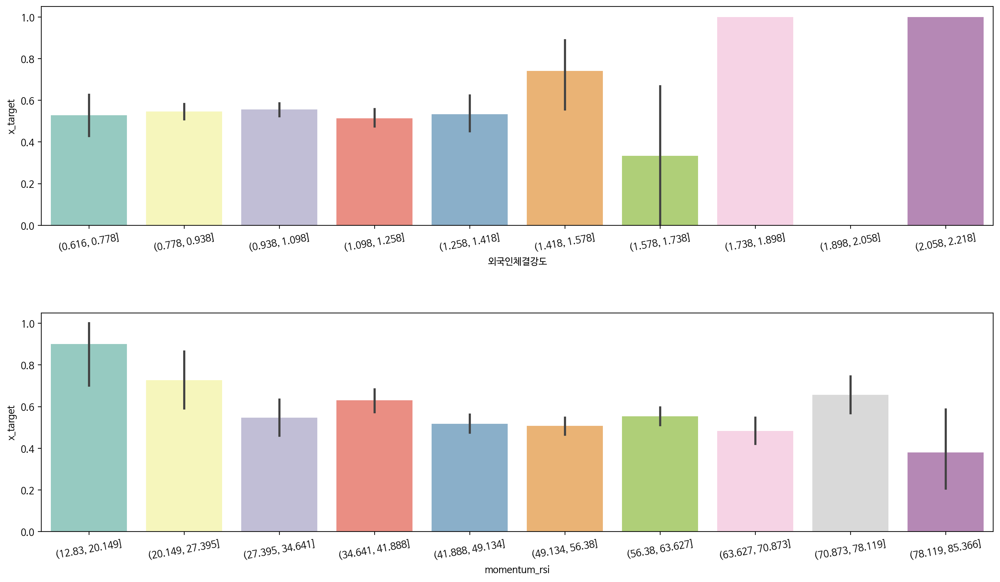

In [ ]:
plt.figure(figsize=(18, len(features)*5))
grid = gridspec.GridSpec(len(features), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = data.copy()

for idx, col in enumerate(features):
        df_cut[col] = pd.cut(data[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='x_target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

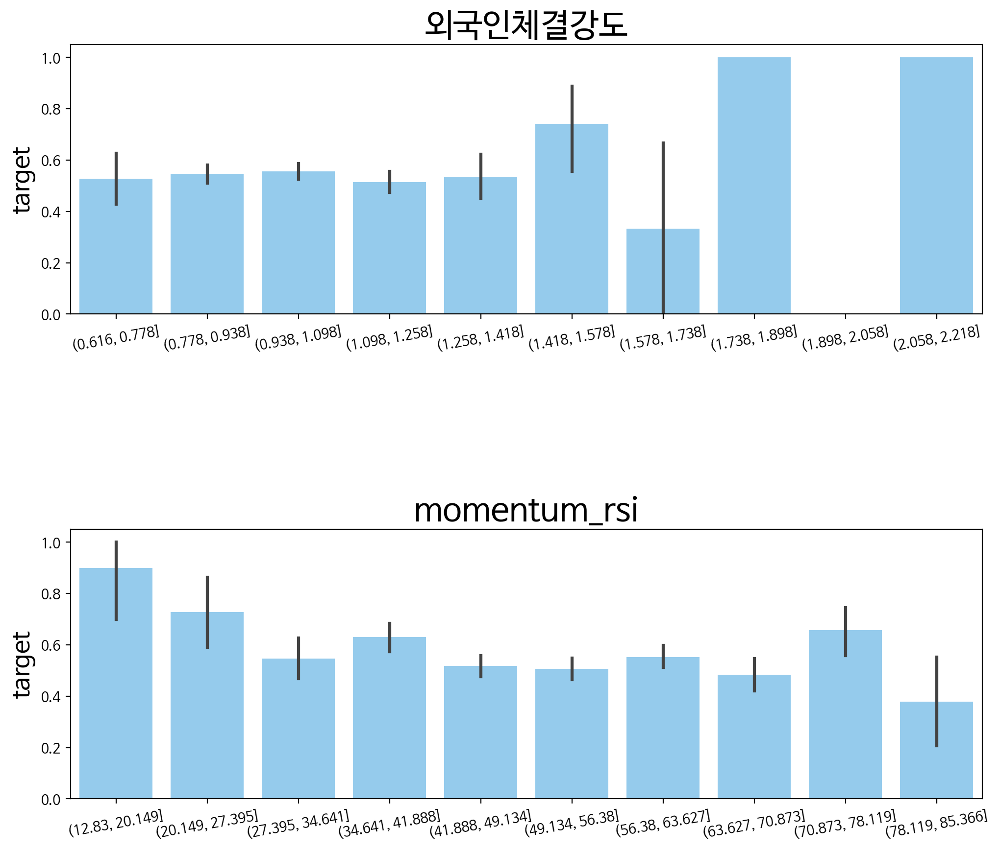

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.gridspec as gridspec

plt.figure(figsize=(12, len(features) * 5))
grid = gridspec.GridSpec(len(features), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.8)  # 그래프 간의 간격 조정

df_cut = data.copy()

for idx, col in enumerate(features):
    df_cut[col] = pd.cut(data[col], 10)

    ax = plt.subplot(grid[idx])
    sns.barplot(x=col, y='x_target', data=df_cut, color='lightskyblue', ax=ax)
    ax.tick_params(axis='x', labelrotation=10)
    ax.set_title(col, fontsize=24)
    ax.set_xlabel('')
    ax.set_ylabel('target', fontsize=18)

plt.show()

## BEFORE

In [ ]:
cols = before.columns

In [ ]:
before.describe()

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,매도_주요그룹_합계,매수_주요그룹_합계,순매수_주요그룹_합계,외국인체결강도,일중강도,개인_활동성,거래대금,기관/개인 매수 비율,기관/개인 매도 비율,일중강도/거래량
count,2500.000000,2500.000000,2500.000000,2500.000000,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,...,2.500000e+03,2.500000e+03,2.500000e+03,2500.000000,2.500000e+03,2.500000e+03,2.500000e+03,2500.000000,2500.000000,2500.000000
mean,2326.613640,2337.408412,2312.828068,2325.337708,5.445324e+08,1.609837e+15,9.647719e+06,9.642497e+06,-5.221694e+03,2.144923e+06,...,3.019707e+07,2.918962e+07,-1.007456e+06,1.015106,3.024548e+07,4.487553e+08,1.325047e+12,0.077779,0.081020,0.058169
std,356.379418,358.768541,353.764799,356.083228,3.104641e+08,3.551656e+14,6.360305e+06,6.464038e+06,5.035146e+06,1.386710e+06,...,1.236883e+07,1.172334e+07,6.806040e+06,0.153945,4.063264e+08,2.797332e+08,9.697003e+11,0.032816,0.033623,0.640970
min,1474.450000,1516.750000,1439.430000,1457.640000,1.688331e+08,9.821697e+14,1.889318e+06,2.468004e+06,-5.051760e+07,5.272920e+05,...,9.948184e+06,9.234918e+06,-5.571440e+07,0.618036,-2.145388e+09,1.282585e+08,3.324764e+11,0.014375,0.014736,-1.000000
25%,2036.730000,2044.032500,2027.307500,2035.540000,3.442068e+08,1.291825e+15,5.465172e+06,5.369714e+06,-2.181722e+06,1.417437e+06,...,2.156780e+07,2.110372e+07,-4.324545e+06,0.904460,-2.246539e+08,2.756150e+08,7.444868e+11,0.055250,0.058473,-0.500426
50%,2253.970000,2266.555000,2241.115000,2250.260000,4.453507e+08,1.517118e+15,7.827158e+06,8.057666e+06,-1.270730e+05,1.884170e+06,...,2.746123e+07,2.703817e+07,-9.171165e+05,0.999707,3.036652e+07,3.571404e+08,1.013444e+12,0.073830,0.076697,0.066992
75%,2510.190000,2517.567500,2496.292500,2507.870000,6.403480e+08,1.953668e+15,1.189579e+07,1.210406e+07,2.051466e+06,2.550744e+06,...,3.558792e+07,3.420793e+07,2.577737e+06,1.110017,2.775496e+08,5.203429e+08,1.540954e+12,0.094736,0.098975,0.650947
max,3305.460000,3316.080000,3295.440000,3305.210000,3.455505e+09,2.339207e+15,1.183432e+08,1.471408e+08,2.879759e+07,2.908441e+07,...,1.397007e+08,1.701817e+08,6.041369e+07,2.217586,3.251331e+09,3.213602e+09,1.073839e+13,0.506967,0.474055,1.000000


In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-pastel')

<ipython-input-14-374ded547138>:4: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-pastel')


In [ ]:
before['target'] = before['target'].apply(lambda x: 0 if x == -1 else 1)
before['target']

TIME
2014-03-07    0
2014-03-10    0
2014-03-11    0
2014-03-12    1
2014-03-13    1
             ..
2024-04-29    1
2024-04-30    1
2024-05-02    1
2024-05-03    1
2024-05-07    0
Name: target, Length: 2500, dtype: int64

In [ ]:
price = ['Open', 'High', 'Low', 'Close', 'Volume', 'MarCap', 'r']

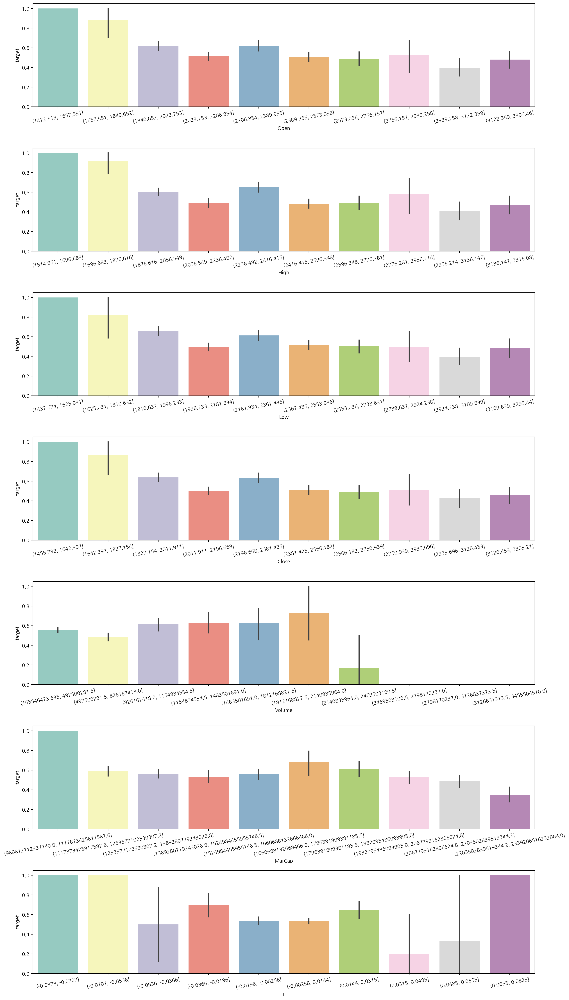

In [ ]:
plt.figure(figsize=(18, len(price)*5))
grid = gridspec.GridSpec(len(price), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(price):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
institutions = ['매도_금융투자',
       '매수_금융투자', '순매수_금융투자', '매도_보험', '매수_보험', '순매수_보험', '매도_투신', '매수_투신',
       '순매수_투신', '매도_사모', '매수_사모', '순매수_사모', '매도_은행', '매수_은행', '순매수_은행',
       '매도_기타금융', '매수_기타금융', '순매수_기타금융', '매도_연기금 등', '매수_연기금 등', '순매수_연기금 등',
       '매도_기관합계', '매수_기관합계', '순매수_기관합계', '매도_기타법인', '매수_기타법인', '순매수_기타법인']

In [ ]:
plt.figure(figsize=(18, len(institutions)*5))
grid = gridspec.GridSpec(len(institutions), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(institutions):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
individual = ['매도_개인', '매수_개인', '순매수_개인', '매도_외국인', '매수_외국인', '순매수_외국인', '매도_기타외국인',
       '매수_기타외국인', '순매수_기타외국인', '매도_전체', '매수_전체']

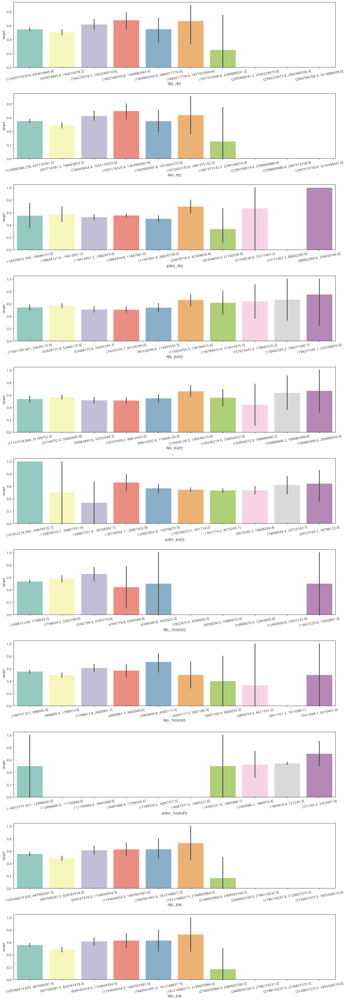

In [ ]:
plt.figure(figsize=(18, len(individual)*5))
grid = gridspec.GridSpec(len(individual), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(individual):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
technical = ['volume_vpt', 'volatility_atr', 'volatility_ui', 'trend_macd_diff',
       'trend_adx', 'trend_trix', 'trend_mass_index', 'trend_dpo',
       'trend_aroon_ind', 'momentum_rsi', 'momentum_wr', 'vol_change_5',
       'ret_5', 'vol_change_10', 'ret_10', 'vol_change_20', 'ret_20', 'std_30',
       'vol_std_30']

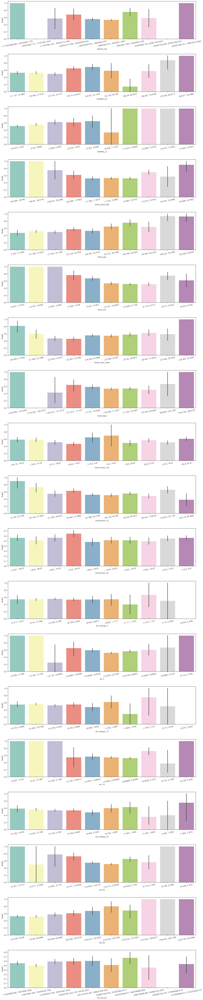

In [ ]:
plt.figure(figsize=(18, len(technical)*5))
grid = gridspec.GridSpec(len(technical), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(technical):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
macroeconomics = ['dowjones', 'nasdaq', 's&p500', '뉴스심리지수', 'USDKRW',
       '경제심리지수', '경상수지', '상품수지', '수출금액 (천불)', '수입금액 (천불)', '무역수지 (천불)']

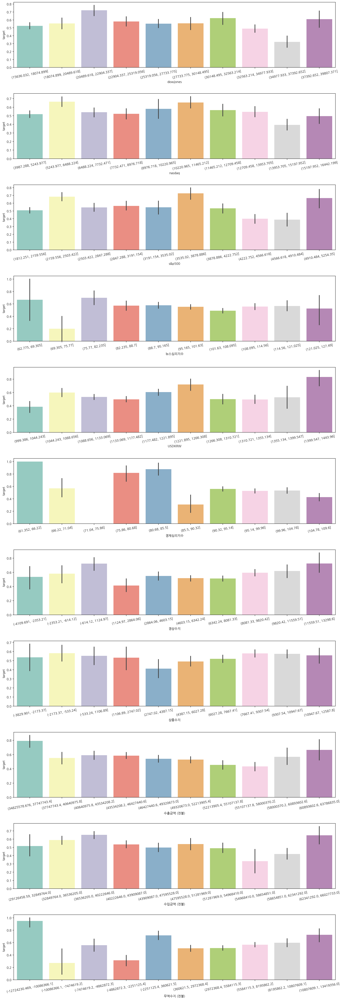

In [ ]:
plt.figure(figsize=(18, len(macroeconomics)*5))
grid = gridspec.GridSpec(len(macroeconomics), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(macroeconomics):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
investors_de = ['매도_주요그룹_합계', '매수_주요그룹_합계', '순매수_주요그룹_합계', '외국인체결강도', '일중강도', '개인_활동성',
       '거래대금', '기관/개인 매수 비율', '기관/개인 매도 비율', '일중강도/거래량']

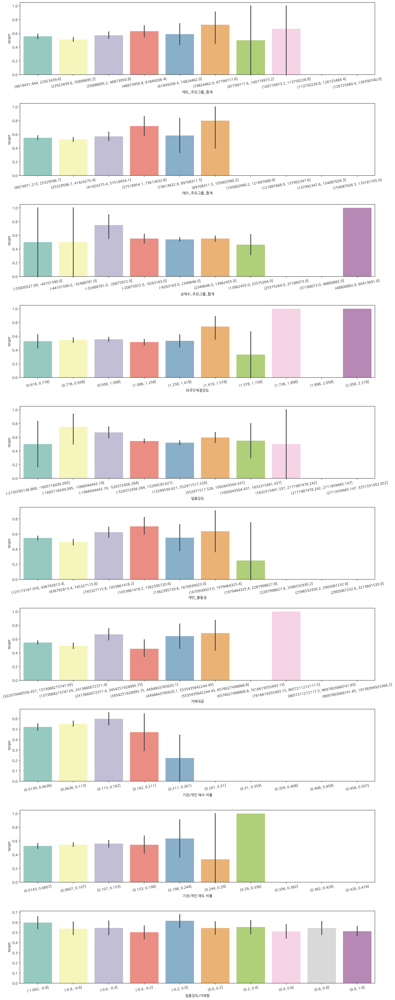

In [ ]:
plt.figure(figsize=(18, len(investors_de)*5))
grid = gridspec.GridSpec(len(investors_de), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = before.copy()

for idx, col in enumerate(investors_de):
        df_cut[col] = pd.cut(before[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

## AFTER

In [ ]:
after.describe()

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,기관/개인 매도 비율,뉴스심리지수,USDKRW,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열)
count,2500.000000,2500.000000,2500.000000,2500.000000,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03,...,2500.000000,2500.00000,2500.000000,2500.000000,2500.000000,2500.000000,2.500000e+03,2.500000e+03,2.500000e+03,2.500000e+03
mean,2326.613640,2337.408412,2312.828068,2325.337708,5.445324e+08,1.609837e+15,9.647719e+06,9.642497e+06,-5.221694e+03,2.144923e+06,...,0.081020,101.10330,1172.930020,95.909400,6052.477720,6974.332240,4.862161e+07,4.487254e+07,3.749070e+06,2.904688e+06
std,356.379418,358.768541,353.764799,356.083228,3.104641e+08,3.551656e+14,6.360305e+06,6.464038e+06,5.035146e+06,1.386710e+06,...,0.033623,9.32157,87.821591,7.848066,2892.402916,3435.557725,5.909460e+06,8.497897e+06,4.415070e+06,6.279025e+05
min,1474.450000,1516.750000,1439.430000,1457.640000,1.688331e+08,9.821697e+14,1.889318e+06,2.468004e+06,-5.051760e+07,5.272920e+05,...,0.014736,62.84000,999.830017,61.400000,-4092.300000,-3813.500000,3.485451e+07,2.916332e+07,-1.269811e+07,1.964954e+06
25%,2036.730000,2044.032500,2027.307500,2035.540000,3.442068e+08,1.291825e+15,5.465172e+06,5.369714e+06,-2.181722e+06,1.417437e+06,...,0.058473,95.49000,1115.730011,93.600000,5170.100000,5527.800000,4.470691e+07,3.848594e+07,1.785262e+06,2.383040e+06
50%,2253.970000,2266.555000,2241.115000,2250.260000,4.453507e+08,1.517118e+15,7.827158e+06,8.057666e+06,-1.270730e+05,1.884170e+06,...,0.076697,101.45500,1155.535034,96.500000,6361.500000,7382.600000,4.820679e+07,4.361967e+07,4.291164e+06,2.763058e+06
75%,2510.190000,2517.567500,2496.292500,2507.870000,6.403480e+08,1.953668e+15,1.189579e+07,1.210406e+07,2.051466e+06,2.550744e+06,...,0.098975,107.33250,1210.329956,100.400000,7717.700000,9341.200000,5.242304e+07,5.100976e+07,6.694203e+06,3.543364e+06
max,3305.460000,3316.080000,3295.440000,3305.210000,3.455505e+09,2.339207e+15,1.183432e+08,1.471408e+08,2.879759e+07,2.908441e+07,...,0.474055,127.49000,1443.959961,109.600000,13298.600000,12587.800000,6.378684e+07,6.602773e+07,1.341936e+07,3.998707e+06


In [ ]:
cols = after.columns

In [ ]:
after['target'] = after['target'].apply(lambda x: 0 if x == -1 else 1)
after['target']

Date
2014-03-07    0
2014-03-10    0
2014-03-11    0
2014-03-12    0
2014-03-13    0
             ..
2024-04-29    1
2024-04-30    1
2024-05-02    1
2024-05-03    1
2024-05-07    1
Name: target, Length: 2500, dtype: int64

In [ ]:
after[after.isnull().any(axis=1)]

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,기관/개인 매도 비율,뉴스심리지수,USDKRW,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열)
Date,,,,,,,,,,,,,,,,,,,,,


In [ ]:
price = ['Open', 'High', 'Low', 'Close', 'Volume', 'MarCap', 'r']

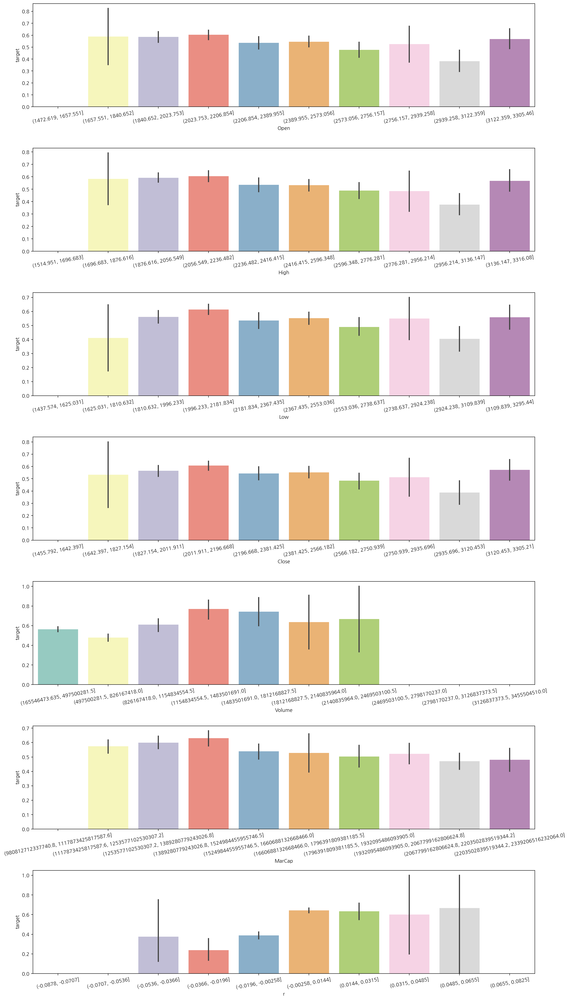

In [ ]:
plt.figure(figsize=(18, len(price)*5))
grid = gridspec.GridSpec(len(price), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(price):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
institutions = ['매도_금융투자',
       '매수_금융투자', '순매수_금융투자', '매도_보험', '매수_보험', '순매수_보험', '매도_투신', '매수_투신',
       '순매수_투신', '매도_사모', '매수_사모', '순매수_사모', '매도_은행', '매수_은행', '순매수_은행',
       '매도_기타금융', '매수_기타금융', '순매수_기타금융', '매도_연기금 등', '매수_연기금 등', '순매수_연기금 등',
       '매도_기관합계', '매수_기관합계', '순매수_기관합계', '매도_기타법인', '매수_기타법인', '순매수_기타법인']

In [ ]:
plt.figure(figsize=(18, len(institutions)*5))
grid = gridspec.GridSpec(len(institutions), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(institutions):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
individual = ['매도_개인', '매수_개인', '순매수_개인', '매도_외국인', '매수_외국인', '순매수_외국인', '매도_기타외국인',
       '매수_기타외국인', '순매수_기타외국인', '매도_전체', '매수_전체']

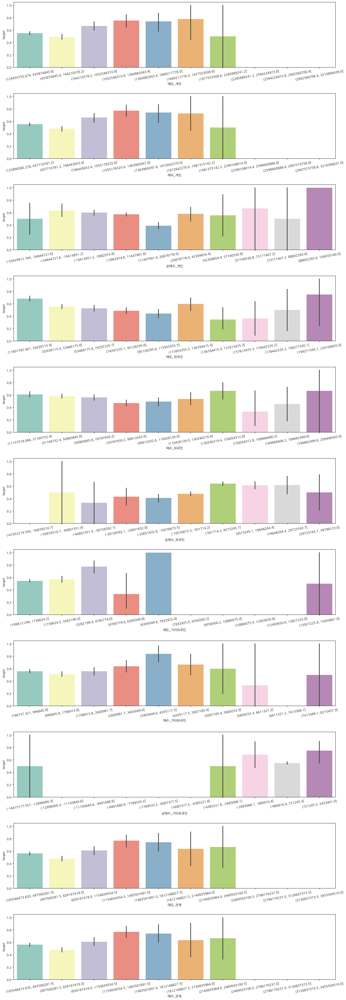

In [ ]:
plt.figure(figsize=(18, len(individual)*5))
grid = gridspec.GridSpec(len(individual), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(individual):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
technical = ['volume_vpt', 'volatility_atr', 'volatility_ui', 'trend_macd_diff',
       'trend_adx', 'trend_trix', 'trend_mass_index', 'trend_dpo',
       'trend_aroon_ind', 'momentum_rsi', 'momentum_wr', 'vol_change_5',
       'ret_5', 'vol_change_10', 'ret_10', 'vol_change_20', 'ret_20', 'std_30',
       'vol_std_30']

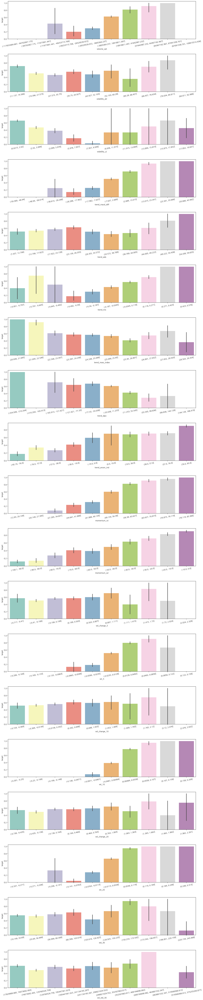

In [ ]:
plt.figure(figsize=(18, len(technical)*5))
grid = gridspec.GridSpec(len(technical), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(technical):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
macroeconomics = ['dowjones', 'nasdaq', 's&p500', '뉴스심리지수', 'USDKRW',
       '경제심리지수', '경상수지', '상품수지', '수출금액 (천불)', '수입금액 (천불)', '무역수지 (천불)']

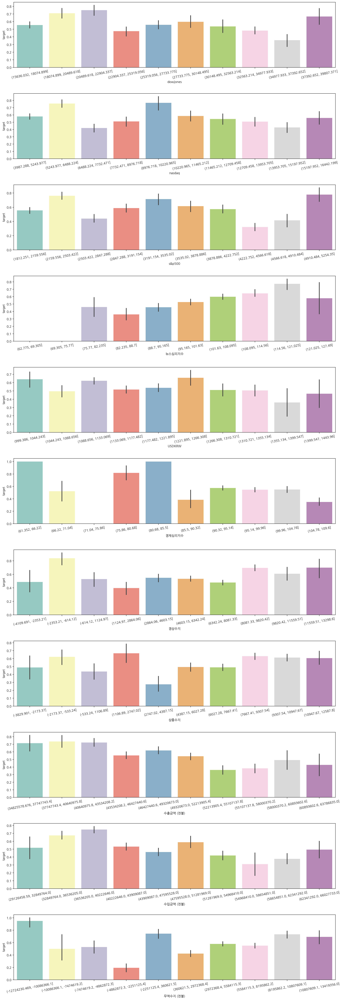

In [ ]:
plt.figure(figsize=(18, len(macroeconomics)*5))
grid = gridspec.GridSpec(len(macroeconomics), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(macroeconomics):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
investors_de = ['금융투자_매수/매도 비율',
       '보험_매수/매도 비율', '매도_주요그룹_합계', '매수_주요그룹_합계', '순매수_주요그룹_합계', '외국인체결강도',
       '개인_활동성', '기관/개인 매수 비율', '기관/개인 매도 비율']

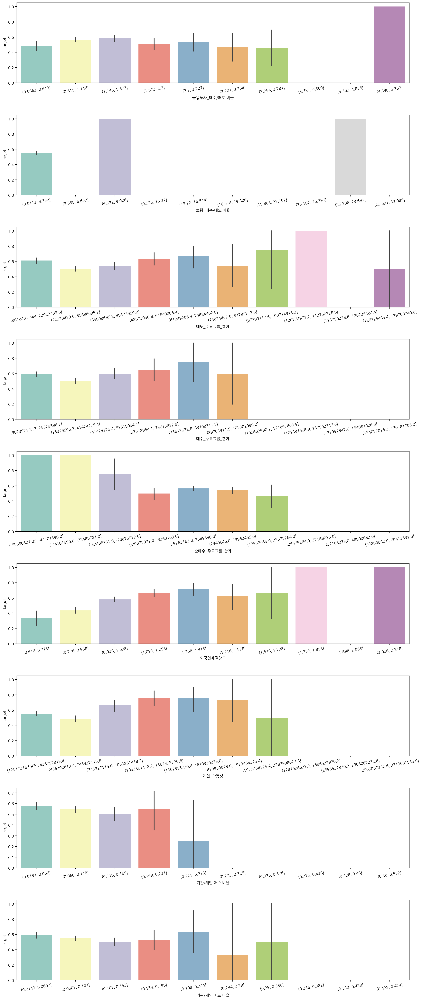

In [ ]:
plt.figure(figsize=(18, len(investors_de)*5))
grid = gridspec.GridSpec(len(investors_de), 1)
plt.subplots_adjust(wspace=0.2, hspace=0.4)

df_cut = after.copy()

for idx, col in enumerate(investors_de):
        df_cut[col] = pd.cut(after[col], 10)

        ax = plt.subplot(grid[idx])
        sns.barplot(x=col, y='target', data=df_cut, palette='Set3', ax=ax)
        ax.tick_params(axis='x', labelrotation=10)

In [ ]:
df

,Open,High,Low,Close,Volume,MarCap,매도_금융투자,매수_금융투자,순매수_금융투자,매도_보험,...,경제심리지수,경상수지,상품수지,수출금액 (천불),수입금액 (천불),무역수지 (천불),M2(평잔 원계열),r,x_target,target
Date,,,,,,,,,,,,,,,,,,,,,
2014-03-07,1979.70,1983.53,1968.66,1974.68,231557237,1171060533144157,3586232,4040200,453968,2641596,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.000476,0,0
2014-03-10,1967.63,1967.66,1951.96,1954.42,214944284,1159472445620989,4957687,3914211,-1043476,3045944,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.010313,0,0
2014-03-11,1957.22,1963.87,1951.20,1963.87,247468004,1164815467875309,3837210,4029193,191983,3804816,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.004824,0,0
2014-03-12,1957.67,1958.09,1930.48,1932.54,329923547,1146460580210853,6588397,7599838,1011441,3966236,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,-0.016082,1,0
2014-03-13,1940.35,1946.28,1931.75,1934.38,259619849,1147366863530616,5901313,6934734,1033421,2884637,...,100.9,5679.6,6701.5,49064392.0,45558675.0,3505717.0,1964954.0,0.000952,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-29,2675.46,2687.44,2665.21,2687.44,470546033,2189691725743463,5353046,10015015,4661969,1479298,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.011644,1,1
2024-04-30,2693.22,2710.23,2687.29,2692.06,460083516,2193843858061216,6073768,9027473,2953705,1548253,...,94.5,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,0.001718,1,1
2024-05-02,2679.04,2692.47,2678.84,2683.65,351087270,2186876849586271,7429768,4868198,-2561570,1366408,...,93.8,6361.5,7382.6,56571841.0,52280677.0,4291164.0,3998706.8,-0.003129,1,1


## 평균

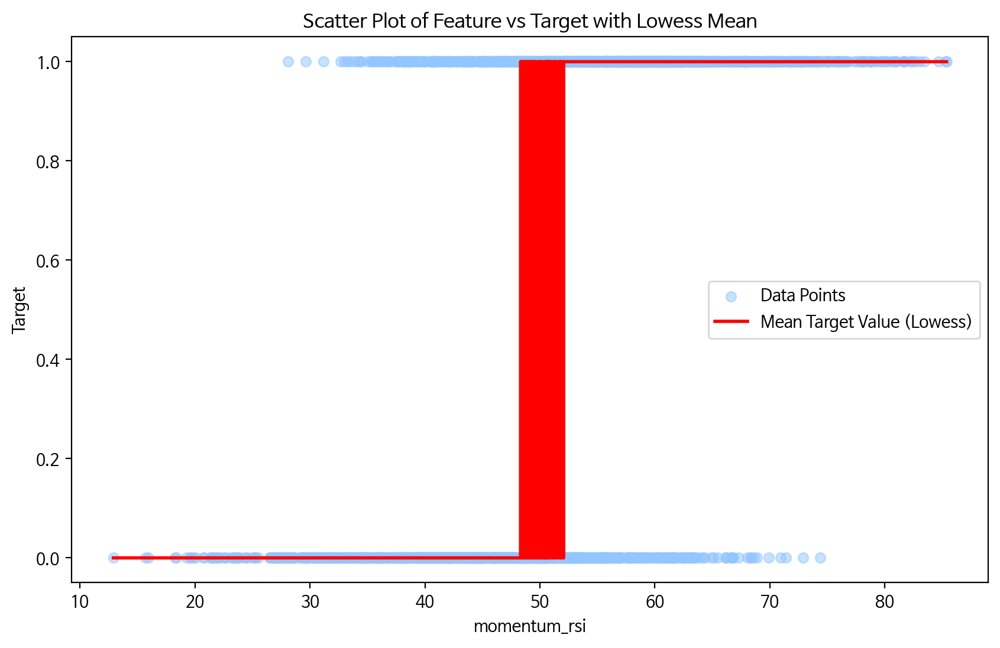

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from statsmodels.nonparametric.smoothers_lowess import lowess

feature = 'momentum_rsi'
target = 'target'

plt.figure(figsize=(10, 6))
plt.scatter(df[feature], df[target], alpha=0.5, label='Data Points')

# 로컬 회귀를 사용하여 피처 값에 따른 타겟 값의 평균 계산
lowess_result = lowess(df[target], df[feature], frac=0.1)

plt.plot(lowess_result[:, 0], lowess_result[:, 1], color='red', linewidth=2, label='Mean Target Value (Lowess)')

plt.xlabel('momentum_rsi')
plt.ylabel('Target')
plt.title('Scatter Plot of Feature vs Target with Lowess Mean')
plt.legend()
plt.show()

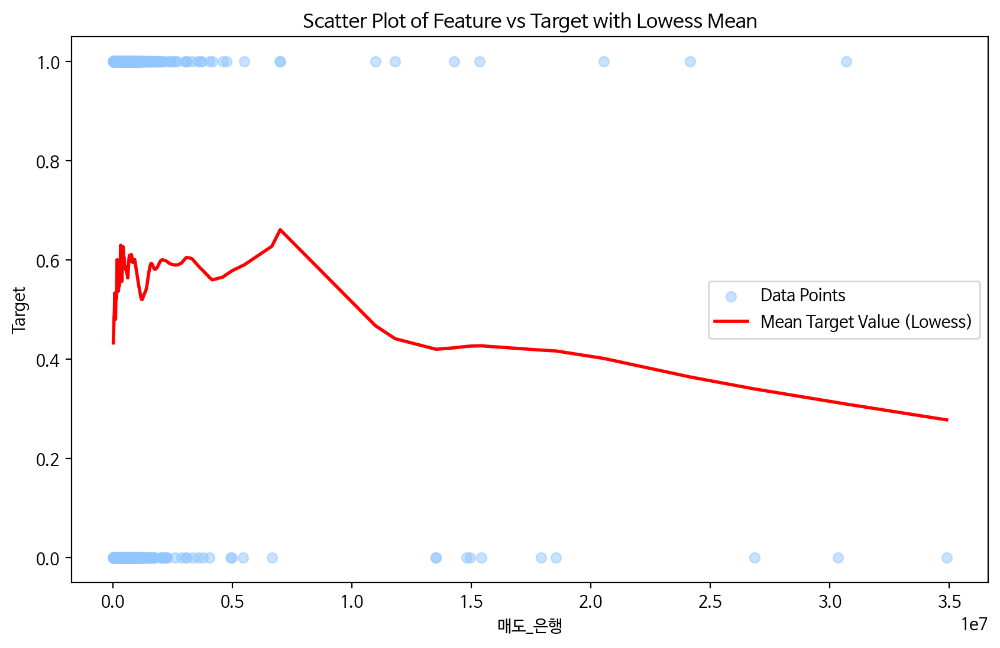

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from statsmodels.nonparametric.smoothers_lowess import lowess

feature = '매도_은행'
target = 'target'

plt.figure(figsize=(10, 6))
plt.scatter(df[feature], df[target], alpha=0.5, label='Data Points')

# 로컬 회귀를 사용하여 피처 값에 따른 타겟 값의 평균 계산
lowess_result = lowess(df[target], df[feature], frac=0.1)

plt.plot(lowess_result[:, 0], lowess_result[:, 1], color='red', linewidth=2, label='Mean Target Value (Lowess)')

plt.xlabel('매도_은행')
plt.ylabel('Target')
plt.title('Scatter Plot of Feature vs Target with Lowess Mean')
plt.legend()
plt.show()